<a href="https://colab.research.google.com/github/rebeca53/gender-data-exploration/blob/main/Gender_Financial_Inclusion_in_Latin_America_(Mexico_and_Brazil)_Notebook.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Gender Financial Inclusion in Latin America (Mexico and Brazil)


Rebeca ([email](al435871@uji.es
)), Rodrigo ([email](al436289@uji.es))


Data Science (SJL006)<br/>
[Erasmus Mundus MSc in Geospatial Technologies](https://mastergeotech.info/)
Academic course 2023/2024, University Jaume I, Spain.

---

## Abstract (100 words maximum)

In Latin America, women experience economic gender-based violence, which refers to women’s access to property rights being taken away. This type of right deprivation can be measured by the financial statistics by gender. With this project, we aim to assess the current state of financial gender inclusion in Mexico and Brazil. Particularly, we will focus on measuring the degree of participation of women in labor and financial income. The scope of this study is at a district level within each country.

## Keywords

economic gender-based violence; gender inclusion; finances; Mexico; Brazil

## SDG Goals

This project relates to the [SDG 5](https://sdgs.un.org/goals/goal5):

<small>

- 5. Achieve gender equality and empower all women and girls

  - 5.A. “Undertake reforms to give women equal rights to economic resources, as well as access to ownership and control over land and other forms of property, financial services, inheritance and natural resources, in accordance with national laws”

</small>

---
---

## INTRODUCTION


---

Briefly explain:

- the motivation for the authors to choose/take the problem. it is highly recommended to state one or two exploratory questions that you want to address through your data analysis notebook.
- identify target users/stakeholders.
- main results/findings.

In the context of economic-based violence, women will be deprived from the rights to own properties and to make financial decisions. Though much of this may happen within family units, it is possible to measure women opportunities to make financial choices considering:
- how are they inserted in the labour market
- if they are making money that can make decisions on.

Therefore, our questions are:
1. Are women inserted in the labour market?
2. How gender impacts paycheck?
3. Is there any spatial-related factor to women insertion in the labour market?
4. Is there any spatial-related factor to women income?
5. What are the main similarities or contrast regarding women financial inclusion between the two countries?



Spatially speaking, we focus on Mexico and Brazil.
And regarding time, we use the most recent data available on both countries, which in this case is 2019.


## DATA & PYTHON MODULES
---





In [ ]:
!pip install forex-python

In [ ]:
# main libraries
import numpy as np
import pandas as pd
import geopandas as gpd

# other imports
import folium
import os
import seaborn as sns
from matplotlib import pyplot as plt
from forex_python.converter import CurrencyRates
from branca.colormap import linear
import branca


In [ ]:
#Check library's version
# !pip show numpy
# !pip show pandas
# !pip show geopandas
# !pip show folium
# !pip show os
# !pip show seaborn
# !pip show matplotlib
# !pip show forex_python.converter
# !pip show branca

Name: numpy
Version: 1.23.5
Summary: NumPy is the fundamental package for array computing with Python.
Home-page: https://www.numpy.org
Author: Travis E. Oliphant et al.
Author-email: 
License: BSD
Location: /usr/local/lib/python3.10/dist-packages
Requires: 
Required-by: albumentations, altair, arviz, astropy, autograd, blis, bokeh, bqplot, chex, cmdstanpy, contourpy, cufflinks, cupy-cuda12x, cvxpy, datascience, db-dtypes, dopamine-rl, ecos, flax, folium, geemap, gensim, gym, h5py, holoviews, hyperopt, ibis-framework, imageio, imbalanced-learn, imgaug, jax, jaxlib, librosa, lida, lightgbm, matplotlib, matplotlib-venn, missingno, mizani, ml-dtypes, mlxtend, moviepy, music21, nibabel, numba, numexpr, opencv-contrib-python, opencv-python, opencv-python-headless, opt-einsum, optax, orbax-checkpoint, osqp, pandas, pandas-gbq, patsy, plotnine, prophet, pyarrow, pycocotools, pyerfa, pymc, pytensor, python-louvain, PyWavelets, qdldl, qudida, scikit-image, scikit-learn, scipy, scs, seaborn, sha

### Python libraries

> List of python libraries used, their version, and purpose for the analysis.


| Library    |     Version | Purpose  |
|------------|-------------|----------|
| numpy      |     1.23.5  | array computing with Python|
| pandas     |     1.5.3   | data structures for data analysis and statistics|
| geopandas  |    0.13.2   | geographic data structures|
| folium     |    0.13.2   | plot maps|
| os         |    0.13.2   | access os commands|
| seaborn    |    0.13.2   | plot graphs|
| matplotlib |    0.13.2   | plot graphs|
| forex_python.converter  |    0.13.2   | currency conversion|
| branca  |    0.13.2   | colormaps in folium maps|

### Data sources

The following table contains the data sets used in the notebook, together with their sources, the data formats they have and a brief description of the type of data retrievable within each of them.

| Data set  |  Format | Source  | Description | Selected/used variables
|-----------|---------|---------|-------------|------------------------
| [Ocuppied people by gender (2019)](https://sidra.ibge.gov.br/tabela/7246) | XLSX |  [IBGE - Brazilian Institute of Geography and Statistics](https://sidra.ibge.gov.br/) | People above 14 years occupied by gender, and work shift| `State Name`, `Occupied Women`, `Occupied Men`, `2019`, etc |
| [Economic Cesnsus of Mexico (2019)](https://www.inegi.org.mx/programas/ce/2019/#datos_abiertos) | CSV |  [INEGI - National Institute of Statistics and Geography](https://www.inegi.org.mx/) | Mexico population economic prospects| `State Code`, `Women`, `Men`, etc |
| [Monthly income by gender (2012-2022)](https://sidra.ibge.gov.br/Tabela/7444) | XLSX | [IBGE - Brazilian Institute of Geography and Statistics](https://sidra.ibge.gov.br/) | Average monthly income of people above 14 years occupied  from all types of work by gender | `State Name`, `Women`, `Men`, `2019`, etc. |
| [Occupation and Employment Survey of Mexico (2019)](https://www.inegi.org.mx/programas/enoe/15ymas/#datos_abiertos) | CSV |  [INEGI - National Institute of Statistics and Geography](https://www.inegi.org.mx/) | Mexico population income figures| `ent`, `sex`, `ingocup`, etc |
| [Geometries of Brazilian states](https://github.com/giuliano-oliveira/geodata-br-states/blob/main/geojson/br_states.json) | JSON | [GitHub - Giuliano Oliveira](https://github.com/giuliano-oliveira/geodata-br-states) | GEOJson file of all brazilian states perimeters | `Estado`, `geometry`, etc. |
| [Geometries of Mexican states](https://www.gits.igg.unam.mx/repositoriodecapas/geojson/gdb_ref_esta_ine_2009.json) | JSON | [GITS - Geotechnology in Infrastructure Transport and Sustainability](https://www.gits.igg.unam.mx/portal/) | GEOJson file of all mexican states | `cve_ent`, `nom_ent`, `geometry`, etc. |

## DATA PREPARATION
---

In [ ]:
# Connection to google drive folder
from google.colab import drive
drive.mount('/content/drive')

# Move into the data folder
os.chdir("/content/drive/My Drive/DataScience/Data Science - Final project/Data")

MessageError: Error: credential propagation was unsuccessful

### Geometries

> Section to obtain state-level geometries of both countries

#### Geometries for Brazil states


In [ ]:
br_states_file = os.path.join(os.getcwd(),'br_states.json')
br_states = gpd.read_file(br_states_file)
br_states.head(3)

,id,fid,FID_Export,SIGLA,Total,Homens,Mulheres,Urbana,Rural,TX_Alfab,FID_estado,Estado,FK_macro,PK_sigla,geometry
0,a__031_003_estadosBrasil.1,1,0,AC,557526.0,280983,276543,370267.0,187259,65.154545,-1,Acre,N,AC,"MULTIPOLYGON (((-66.80619 -9.81446, -66.64485 ..."
1,a__031_003_estadosBrasil.2,2,1,AL,2822621.0,1378942,1443679,1919739.0,902882,59.364356,-1,Alagoas,NE,AL,"MULTIPOLYGON (((-35.15263 -8.91373, -35.15628 ..."
2,a__031_003_estadosBrasil.3,3,2,AM,2812557.0,1414367,1398190,2107222.0,705335,72.250000,-1,Amazonas,N,AM,"MULTIPOLYGON (((-67.32590 2.02976, -67.30001 1..."


In [ ]:
# Remove extra columns
br_states = br_states.drop(columns=['id','fid','FID_Export','TX_Alfab', 'FID_estado','PK_sigla'])
br_states.columns

Index(['SIGLA', 'Total', 'Homens', 'Mulheres', 'Urbana', 'Rural', 'Estado',
       'FK_macro', 'geometry'],
      dtype='object')

In [ ]:
geobr_states = gpd.GeoDataFrame(br_states, crs="EPSG:4326")

#### Geometries for Mexico states


In [ ]:
mx_states_geo = gpd.read_file('https://www.gits.igg.unam.mx/repositoriodecapas/geojson/gdb_ref_esta_ine_2009.json')

# Rearrengement of data
mx_states_geo['state_code'] = mx_states_geo['cve_ent'].apply(lambda code:int(code)) #parsing string code as integer in new column
mx_states_geo.rename(columns = {'nom_ent':'State name'},inplace=True)
crs = mx_states_geo.crs
print(f'CRS code of this geodataframe: {crs}')

mx_states_geo.head(2)

CRS code of this geodataframe: EPSG:4326


,id,gid,objectid,cve_ent,State name,abrv_edo,shape_leng,shape_area,geometry,state_code
0,gdb_ref_esta_ine_2009.1,1,1,04,Campeche,CAMP,13.950837,4.930581,"MULTIPOLYGON (((-92.35059 18.67031, -92.34984 ...",4
1,gdb_ref_esta_ine_2009.2,2,2,03,Baja California Sur,BCS,26.652438,6.723347,"MULTIPOLYGON (((-111.38365 26.29082, -111.3837...",3


### The first variable: Participation in labour
> In this section the *number of people employed by gender* in 2019 in Brazil and in Mexico is obtained.

A ratio of these two figures is calculated by country to search for answers to questions 1 and 3, regarding *women insertion in the job market*.

####Brazil

In [ ]:
# Read the table
file_path = os.path.join(os.getcwd(),'Tabela 7246.xlsx')

# Use cached file; Otherwise, raise error
if (os.path.isfile(file_path)):
  employment_br_states = pd.read_excel(file_path)
else:
  print(f'No file {file_path} exists!')

employment_br_states.head()

,"Tabela 7246 - Pessoas de 14 anos ou mais de idade ocupadas na semana de referência, por sexo e turno no trabalho principal",Unnamed: 1,Unnamed: 2,Unnamed: 3
0,Variável - Pessoas de 14 anos ou mais de idade...,NaN,NaN,NaN
1,Turno no trabalho - Total,NaN,NaN,NaN
2,Ano - 2019,NaN,NaN,NaN
3,Unidade da Federação,Sexo,NaN,NaN
4,NaN,Total,Homens,Mulheres


In [ ]:
# Translate Portuguese to English
pt_to_en = {'Total':'Total employed', 'Homens':'Men','Mulheres':'Women'}
pt_to_en['Homens']

employment_br_states.iloc[4] = employment_br_states.iloc[4].map(pt_to_en)

In [ ]:
# use gender row as the columns names
employment_br_states.columns = employment_br_states.iloc[4]
employment_br_states.columns = employment_br_states.columns.fillna("State Name")
employment_br_states.head()

4,State Name,Total employed,Men,Women
0,Variável - Pessoas de 14 anos ou mais de idade...,NaN,NaN,NaN
1,Turno no trabalho - Total,NaN,NaN,NaN
2,Ano - 2019,NaN,NaN,NaN
3,Unidade da Federação,Sexo,NaN,NaN
4,NaN,Total employed,Men,Women


In [ ]:
# Drop the rows with null values
employment_br_states = employment_br_states.dropna()
employment_br_states.head(3)

4,State Name,Total employed,Men,Women
5,Rondônia,815,493,323
6,Acre,304,182,122
7,Amazonas,1640,995,644


In [ ]:
# Check if we have 27 rows, one to each state
employment_br_states.shape

(27, 4)

In [ ]:
# Check data types
employment_br_states.dtypes

4
State Name        object
Total employed    object
Men               object
Women             object
dtype: object

In [ ]:
# Change data types to int so we can use them to make calculations
employment_br_states = employment_br_states.astype({'Total employed': 'int',
                                                    'Men': 'int',
                                                    'Women': 'int'})
employment_br_states.dtypes

4
State Name        object
Total employed     int64
Men                int64
Women              int64
dtype: object

In [ ]:
# Calculate the percentages
employment_br_states["Percentage of occupied women"] =employment_br_states['Women']/employment_br_states['Total employed']
employment_br_states["Percentage of occupied men"] = employment_br_states['Men']/employment_br_states['Total employed']

employment_br_states.head()

4,State Name,Total employed,Men,Women,Percentage of occupied women,Percentage of occupied men
5,Rondônia,815,493,323,0.396319,0.604908
6,Acre,304,182,122,0.401316,0.598684
7,Amazonas,1640,995,644,0.392683,0.606707
8,Roraima,219,130,89,0.406393,0.593607
9,Pará,3518,2192,1326,0.376919,0.623081


In [ ]:
# Fix the index row
employment_br_states = employment_br_states.rename_axis(None, axis=1)
employment_br_states = employment_br_states.reset_index(drop=True)
employment_br_states.head(2)

,State Name,Total employed,Men,Women,Percentage of occupied women,Percentage of occupied men
0,Rondônia,815,493,323,0.396319,0.604908
1,Acre,304,182,122,0.401316,0.598684


In [ ]:
# Check the datatypes
employment_br_states.dtypes

State Name                       object
Total employed                    int64
Men                               int64
Women                             int64
Percentage of occupied women    float64
Percentage of occupied men      float64
dtype: object

In [ ]:
# Calculate National-level
employment_distribution_br = employment_br_states.filter(items=['Total employed',
       'Women', 'Men']).agg(['sum'])
employment_distribution_br["Percentage of occupied women"] = employment_distribution_br['Women']/employment_distribution_br['Total employed']
employment_distribution_br["Percentage of occupied men"] = employment_distribution_br['Men']/employment_distribution_br['Total employed']

employment_distribution_br

,Total employed,Women,Men,Percentage of occupied women,Percentage of occupied men
sum,94955,40610,54347,0.427676,0.572345


####Mexico

The analysis for Mexico is broken in national and state level, due to the structure of the data in multiple files: the Economic Census data of Mexico is shared by the government in a **relational database** format with CSV files containing different tables.


#####National level

In [ ]:
# Import national-level table with data from the Economic Census (2019)
file_path = os.path.join(os.getcwd(),'ce2019_nac.csv')#edited csv file since a comma was missing in the column-name row at the end

# Use cached file; Otherwise, raise error
if (os.path.isfile(file_path)):
  economic_census_mx_2019 = pd.read_csv(file_path, sep=',')
else:
  print(f'No file {file_path} exists!')

economic_census_mx_2019.head(2)

,ENTIDAD,MUNICIPIO,CODIGO,ID_ESTRATO,UE,A111A,A121A,A131A,A211A,A221A,...,A433A,A434A,A436A,A529A,A534A,A747A,A748A,A752A,A764A,Unnamed: 186
0,\t,,,NaN,4800157,2.221225e+07,1.222845e+07,9983800.258,893956.138,746451.840,...,174.571,92.873,1084154.128,8.035,30.922,338.244,638.349,86.186,41.258,NaN
1,\t,,,1.0,4555263,2.418236e+06,9.557533e+05,1462482.828,23372.595,26762.926,...,177.960,95.629,400706.606,8.028,35.112,208.822,298.456,115.636,48.679,NaN


In [ ]:
# Retrieve economic activity level table

# Read file with table
economic_activities_path = os.path.join(os.getcwd(),'ce2019_activity_code.csv')
# Use cached file; Otherwise, raise error
if (os.path.isfile(file_path)):
  economic_activities = pd.read_csv(economic_activities_path, sep=',')
else:
  print(f'No file {file_path} exists!')

# Filter and rename columns
economic_activities = economic_activities[['CODIGO','CLASIFICADOR_CODIGO']]
economic_activities = economic_activities.rename(columns = {'CODIGO':'activity_code','CLASIFICADOR_CODIGO':'Level of activity'})
economic_activities.at[0,'activity_code']=0 #assigning a '0' label to NaN in preparation for merge with census table
economic_activities.head(3)

,activity_code,Level of activity
0,0,Gran Sector
1,11,Sector
2,112,Subsector


In [ ]:
# Processing of national-level Economic Census data

# Filter national-level census data
census_national_data = economic_census_mx_2019.loc[economic_census_mx_2019['ID_ESTRATO'].isnull()]

#assigning a '0' label to NaN in preparation for merge with activity code
census_national_data.at[0,'CODIGO']=0

# Merge data with level of activity table:
census_national_data = census_national_data.merge(economic_activities, left_on='CODIGO', right_on='activity_code')

# Filter data by level of activity type to avoid repetition of counts with 'subsector' and 'branch' lower levels
census_national_data = census_national_data.loc[census_national_data['Level of activity']=='Gran Sector']

# Summarize data found
employment_mx = [census_national_data['H001C'][0], #column for employed women
            census_national_data['H001B'][0],  #column for employed men
            census_national_data['H001A'][0]]  #column for employed total population (both genders)

employment_mx

[11194399.0, 15938528.0, 27132927.0]

In [ ]:
# Construct a dataframe for later reference
# | Percentage of jobs occupied by women | Percentage of jobs occupied by men |
array = [employment_mx[:2]/employment_mx[2]]
employment_distribution_mx = pd.DataFrame(array,columns=['Percentage of jobs occupied by women', 'Percentage of jobs occupied by men'])
employment_distribution_mx

,Percentage of jobs occupied by women,Percentage of jobs occupied by men
0,0.412576,0.587424


#####State level

In [ ]:
# Construct DataFrame of the states of Mexico
# | state_code | State Name |

# Read table with
file_path = os.path.join(os.getcwd(),'tc_entidad_municipio.csv')

# Use cached file; Otherwise, raise error
if (os.path.isfile(file_path)):
  mx_states = pd.read_csv(file_path, sep=',')
else:
  print(f'No file {file_path} exists!')

# Filter state-level rows
mx_states = mx_states.loc[mx_states['MUNICIPIO']=='\t'][['ENTIDAD','NOMBRE_ENTIDAD']]

# Rename columns
mx_states = mx_states.rename(columns={'ENTIDAD':'state_code','NOMBRE_ENTIDAD':'State Name'})

# Correct state_code format
def correct_code(code):
  if len(code)>2:
    return int(code[-2:]) #take the last 2 chars and converting to integer
  else:
    return 0 #national level code (i.e. blank "code" converted to 0)

mx_states['state_code']=mx_states['state_code'].apply(lambda x : correct_code(x))
mx_states.head(3)

,state_code,State Name
0,0,Nacional
1,1,Aguascalientes
13,2,Baja California


In [ ]:
# Retrieve the Economic Census file names of each state
os.chdir("/content/drive/My Drive/DataScience/Data Science - Final project/Data")
directory = 'Economic_census_mexico_2019_by_state'
mx_census_state_files = []
for file_name in os.listdir(directory):
  mx_census_state_files.append(file_name) #storing file names in a list
len(mx_census_state_files) #number of files catched

32

In [ ]:
# Function to process each state file

def obtain_occupation_distribution(file_name):
  # Read state file
  os.chdir("/content/drive/My Drive/DataScience/Data Science - Final project/Data/Economic_census_mexico_2019_by_state")
  file_path = os.path.join(os.getcwd(),file_name)
  economic_census_state = pd.read_csv(file_path, sep=',')
  state_code = economic_census_state['ENTIDAD'].iloc[0] #storing state code to return to user

  # Filter non-stratum data (i.e. obtain whole-state level data)
  economic_census_state = economic_census_state.loc[economic_census_state['ID_ESTRATO'].isnull()]
  economic_census_state.at[0,'CODIGO']=0 #assigning a '0' label to NaN in preparation for merge with activity level

  # Merge data with activity level table
  merged_state_data = economic_census_state.merge(economic_activities, left_on='CODIGO', right_on='activity_code')

  # Filter data by level of activity type to avoid repetition of counts with lower levels
  filtered_data = merged_state_data.loc[merged_state_data['Level of activity']=='Gran Sector']

  # Summarize data found to obtain desired figures
  employment_state = [filtered_data['H001C'][0], # women (formally) occupied
              filtered_data['H001B'][0]] # men (formally) occupied

  employment_distribubtion_state = employment_state/sum(employment_state)
  return state_code, employment_distribubtion_state

# Try function with an example:
file_name = mx_census_state_files[14]
obtain_occupation_distribution(file_name)

<ipython-input-26-d97d02aa67ba>:7: DtypeWarning: Columns (1) have mixed types. Specify dtype option on import or set low_memory=False.
  economic_census_state = pd.read_csv(file_path, sep=',')


(15, array([0.42350432, 0.57649568]))

In [ ]:
# Construct DataFrame of participation in labour for all states
employment_mx_state_df = pd.DataFrame(columns=['state_code','Percentage of jobs occupied by women', 'Percentage of jobs occupied by men'])

for file_name in mx_census_state_files:
  state_data = obtain_occupation_distribution(file_name) #applying function to each state file to retrieve figures
  row = pd.Series({'state_code' : state_data[0],
          'Percentage of jobs occupied by women': state_data[1][0],
          'Percentage of jobs occupied by men' : state_data[1][1],
          })
  employment_mx_state_df = pd.concat([employment_mx_state_df, row.to_frame().T], ignore_index=True)

employment_mx_state_df.head(4)

<ipython-input-26-d97d02aa67ba>:7: DtypeWarning: Columns (1) have mixed types. Specify dtype option on import or set low_memory=False.
  economic_census_state = pd.read_csv(file_path, sep=',')
<ipython-input-26-d97d02aa67ba>:7: DtypeWarning: Columns (1) have mixed types. Specify dtype option on import or set low_memory=False.
  economic_census_state = pd.read_csv(file_path, sep=',')
<ipython-input-26-d97d02aa67ba>:7: DtypeWarning: Columns (1) have mixed types. Specify dtype option on import or set low_memory=False.
  economic_census_state = pd.read_csv(file_path, sep=',')
<ipython-input-26-d97d02aa67ba>:7: DtypeWarning: Columns (1,2) have mixed types. Specify dtype option on import or set low_memory=False.
  economic_census_state = pd.read_csv(file_path, sep=',')
<ipython-input-26-d97d02aa67ba>:7: DtypeWarning: Columns (1) have mixed types. Specify dtype option on import or set low_memory=False.
  economic_census_state = pd.read_csv(file_path, sep=',')
<ipython-input-26-d97d02aa67ba>:7

,state_code,Percentage of jobs occupied by women,Percentage of jobs occupied by men
0,1.0,0.396026,0.603974
1,3.0,0.382318,0.617682
2,4.0,0.373910,0.626090
3,2.0,0.410370,0.589630


In [ ]:
# Merge DataFrame with states DataFrame and rearrange columns
employment_mx_state = employment_mx_state_df.merge(mx_states,left_on='state_code',right_on='state_code')
employment_mx_state.sort_values(by=['state_code'])
col_reordering = ['state_code','State Name','Percentage of jobs occupied by women','Percentage of jobs occupied by men']
employment_mx_state = employment_mx_state.reindex(columns = col_reordering)
employment_mx_state.head(2)

,state_code,State Name,Percentage of jobs occupied by women,Percentage of jobs occupied by men
0,1.0,Aguascalientes,0.396026,0.603974
1,3.0,Baja California Sur,0.382318,0.617682


### The second variable: monthly income
> In this section the *average monthly income by gender* in 2019 is calculated for Brazil and Mexico.

The processing of these figures aimes to give answer to questions 2 and 4, that refer to the status of women's wages.

In [ ]:
# Functions to convert currencies to a common currency (USD)
def brl_to_usd(value):
  return CurrencyRates().convert('BRL', 'USD', value)

def mxn_to_usd(value):
  return CurrencyRates().convert('MXN', 'USD', value)

####Brazil

In [ ]:
# Read the table
os.chdir("/content/drive/My Drive/DataScience/Data Science - Final project/Data")
file_path = os.path.join(os.getcwd(),'Tabela 7444.xlsx')

# Use cached file; Otherwise, raise error
if (os.path.isfile(file_path)):
  raw_income_brazil = pd.read_excel(file_path)
else:
  print(f'No file {file_path} exists!')

raw_income_brazil.head()

,"Tabela 7444 - Rendimento médio mensal real das pessoas de 14 anos ou mais de idade ocupadas na semana de referência com rendimento de trabalho, de todos os trabalhos, a preços médios do último ano, por sexo",Unnamed: 1,Unnamed: 2,Unnamed: 3,Unnamed: 4,Unnamed: 5,Unnamed: 6,Unnamed: 7,Unnamed: 8,Unnamed: 9,...,Unnamed: 24,Unnamed: 25,Unnamed: 26,Unnamed: 27,Unnamed: 28,Unnamed: 29,Unnamed: 30,Unnamed: 31,Unnamed: 32,Unnamed: 33
0,Variável - Rendimento médio mensal real das pe...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,Unidade da Federação,Ano x Sexo,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,NaN,2012,NaN,NaN,2013,NaN,NaN,2014,NaN,NaN,...,NaN,2020,NaN,NaN,2021,NaN,NaN,2022,NaN,NaN
3,NaN,Total,Homens,Mulheres,Total,Homens,Mulheres,Total,Homens,Mulheres,...,Mulheres,Total,Homens,Mulheres,Total,Homens,Mulheres,Total,Homens,Mulheres
4,Rondônia,2257,2436,1944,2268,2467,1898,2263,2483,1855,...,2008,2323,2460,2108,2195,2365,1905,2334,2554,1971


In [ ]:
# Format the data frame
# | state | (year) total | (year) men | (year) women

# Fill the null values in the Year row
raw_income_brazil.iloc[2] = raw_income_brazil.iloc[2].fillna(method='ffill')
raw_income_brazil.head(3)

,"Tabela 7444 - Rendimento médio mensal real das pessoas de 14 anos ou mais de idade ocupadas na semana de referência com rendimento de trabalho, de todos os trabalhos, a preços médios do último ano, por sexo",Unnamed: 1,Unnamed: 2,Unnamed: 3,Unnamed: 4,Unnamed: 5,Unnamed: 6,Unnamed: 7,Unnamed: 8,Unnamed: 9,...,Unnamed: 24,Unnamed: 25,Unnamed: 26,Unnamed: 27,Unnamed: 28,Unnamed: 29,Unnamed: 30,Unnamed: 31,Unnamed: 32,Unnamed: 33
0,Variável - Rendimento médio mensal real das pe...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,Unidade da Federação,Ano x Sexo,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,NaN,2012,2012,2012,2013,2013,2013,2014,2014,2014,...,2019,2020,2020,2020,2021,2021,2021,2022,2022,2022


In [ ]:
# Translate Portuguese to English
pt_to_en = {'Total':'Total', 'Homens':'Men','Mulheres':'Women'}

raw_income_brazil.iloc[3] = raw_income_brazil.iloc[3].map(pt_to_en)

In [ ]:
# Combine gender and year in a string value
raw_income_brazil.iloc[2] = raw_income_brazil.iloc[2]+' '+raw_income_brazil.iloc[3]
raw_income_brazil.head()

,"Tabela 7444 - Rendimento médio mensal real das pessoas de 14 anos ou mais de idade ocupadas na semana de referência com rendimento de trabalho, de todos os trabalhos, a preços médios do último ano, por sexo",Unnamed: 1,Unnamed: 2,Unnamed: 3,Unnamed: 4,Unnamed: 5,Unnamed: 6,Unnamed: 7,Unnamed: 8,Unnamed: 9,...,Unnamed: 24,Unnamed: 25,Unnamed: 26,Unnamed: 27,Unnamed: 28,Unnamed: 29,Unnamed: 30,Unnamed: 31,Unnamed: 32,Unnamed: 33
0,Variável - Rendimento médio mensal real das pe...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,Unidade da Federação,Ano x Sexo,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,NaN,2012 Total,2012 Men,2012 Women,2013 Total,2013 Men,2013 Women,2014 Total,2014 Men,2014 Women,...,2019 Women,2020 Total,2020 Men,2020 Women,2021 Total,2021 Men,2021 Women,2022 Total,2022 Men,2022 Women
3,NaN,Total,Men,Women,Total,Men,Women,Total,Men,Women,...,Women,Total,Men,Women,Total,Men,Women,Total,Men,Women
4,Rondônia,2257,2436,1944,2268,2467,1898,2263,2483,1855,...,2008,2323,2460,2108,2195,2365,1905,2334,2554,1971


In [ ]:
# Use the Year + Gender row as the columns names
raw_income_brazil.columns = raw_income_brazil.iloc[2]
raw_income_brazil.columns = raw_income_brazil.columns.fillna("State Name")
raw_income_brazil.head()

2,State Name,2012 Total,2012 Men,2012 Women,2013 Total,2013 Men,2013 Women,2014 Total,2014 Men,2014 Women,...,2019 Women,2020 Total,2020 Men,2020 Women,2021 Total,2021 Men,2021 Women,2022 Total,2022 Men,2022 Women
0,Variável - Rendimento médio mensal real das pe...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,Unidade da Federação,Ano x Sexo,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,NaN,2012 Total,2012 Men,2012 Women,2013 Total,2013 Men,2013 Women,2014 Total,2014 Men,2014 Women,...,2019 Women,2020 Total,2020 Men,2020 Women,2021 Total,2021 Men,2021 Women,2022 Total,2022 Men,2022 Women
3,NaN,Total,Men,Women,Total,Men,Women,Total,Men,Women,...,Women,Total,Men,Women,Total,Men,Women,Total,Men,Women
4,Rondônia,2257,2436,1944,2268,2467,1898,2263,2483,1855,...,2008,2323,2460,2108,2195,2365,1905,2334,2554,1971


In [ ]:
# Drop the rows with null values
income_br = raw_income_brazil.dropna()
income_br.head()

2,State Name,2012 Total,2012 Men,2012 Women,2013 Total,2013 Men,2013 Women,2014 Total,2014 Men,2014 Women,...,2019 Women,2020 Total,2020 Men,2020 Women,2021 Total,2021 Men,2021 Women,2022 Total,2022 Men,2022 Women
4,Rondônia,2257,2436,1944,2268,2467,1898,2263,2483,1855,...,2008,2323,2460,2108,2195,2365,1905,2334,2554,1971
5,Acre,2441,2560,2257,2293,2394,2120,2357,2419,2250,...,2197,2323,2482,2080,2160,2264,1995,2219,2240,2186
6,Amazonas,2466,2550,2318,2438,2548,2257,2400,2626,2004,...,1995,2162,2163,2160,1994,2090,1834,1988,2052,1891
7,Roraima,2904,3158,2524,2897,3024,2706,2656,2812,2418,...,2245,2494,2695,2182,2519,2609,2381,2540,2663,2359
8,Pará,1955,2092,1720,1905,2003,1732,1950,2090,1702,...,1734,1946,1982,1885,1859,1938,1716,1911,2007,1743


In [ ]:
# Fix the index column
income_br = income_br.rename_axis(None, axis=1)
income_br = income_br.reset_index(drop=True)
income_br.head(2)

,State Name,2012 Total,2012 Men,2012 Women,2013 Total,2013 Men,2013 Women,2014 Total,2014 Men,2014 Women,...,2019 Women,2020 Total,2020 Men,2020 Women,2021 Total,2021 Men,2021 Women,2022 Total,2022 Men,2022 Women
0,Rondônia,2257,2436,1944,2268,2467,1898,2263,2483,1855,...,2008,2323,2460,2108,2195,2365,1905,2334,2554,1971
1,Acre,2441,2560,2257,2293,2394,2120,2357,2419,2250,...,2197,2323,2482,2080,2160,2264,1995,2219,2240,2186


In [ ]:
# Check that the dtype is object
income_br.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 27 entries, 0 to 26
Data columns (total 34 columns):
 #   Column      Non-Null Count  Dtype 
---  ------      --------------  ----- 
 0   State Name  27 non-null     object
 1   2012 Total  27 non-null     object
 2   2012 Men    27 non-null     object
 3   2012 Women  27 non-null     object
 4   2013 Total  27 non-null     object
 5   2013 Men    27 non-null     object
 6   2013 Women  27 non-null     object
 7   2014 Total  27 non-null     object
 8   2014 Men    27 non-null     object
 9   2014 Women  27 non-null     object
 10  2015 Total  27 non-null     object
 11  2015 Men    27 non-null     object
 12  2015 Women  27 non-null     object
 13  2016 Total  27 non-null     object
 14  2016 Men    27 non-null     object
 15  2016 Women  27 non-null     object
 16  2017 Total  27 non-null     object
 17  2017 Men    27 non-null     object
 18  2017 Women  27 non-null     object
 19  2018 Total  27 non-null     object
 20  2018 Men    

In [ ]:
# Convert the object types
income_br = income_br.astype({col: int for col in income_br.columns[1:]})
income_br.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 27 entries, 0 to 26
Data columns (total 34 columns):
 #   Column      Non-Null Count  Dtype 
---  ------      --------------  ----- 
 0   State Name  27 non-null     object
 1   2012 Total  27 non-null     int64 
 2   2012 Men    27 non-null     int64 
 3   2012 Women  27 non-null     int64 
 4   2013 Total  27 non-null     int64 
 5   2013 Men    27 non-null     int64 
 6   2013 Women  27 non-null     int64 
 7   2014 Total  27 non-null     int64 
 8   2014 Men    27 non-null     int64 
 9   2014 Women  27 non-null     int64 
 10  2015 Total  27 non-null     int64 
 11  2015 Men    27 non-null     int64 
 12  2015 Women  27 non-null     int64 
 13  2016 Total  27 non-null     int64 
 14  2016 Men    27 non-null     int64 
 15  2016 Women  27 non-null     int64 
 16  2017 Total  27 non-null     int64 
 17  2017 Men    27 non-null     int64 
 18  2017 Women  27 non-null     int64 
 19  2018 Total  27 non-null     int64 
 20  2018 Men    

In [ ]:
# Filter only the information about 2019
income_br_2019 = income_br.filter(items=['State Name', '2019 Total', '2019 Men', '2019 Women'])

In [ ]:
# convert BRL to USD
income_br_2019[['2019 Total', '2019 Men', '2019 Women']] = income_br_2019.filter(items=['2019 Total', '2019 Men', '2019 Women']).apply(brl_to_usd)

In [ ]:
# Calculate percentages
# relative income women/men
income_br_2019['2019 Women/Men'] = income_br_2019['2019 Women']/income_br_2019['2019 Men']

In [ ]:
income_br_2019

,State Name,2019 Total,2019 Men,2019 Women,2019 Women/Men
0,Rondônia,485.027662,533.307287,407.333980,0.763789
1,Acre,467.379228,481.781973,445.673682,0.925053
2,Amazonas,419.505314,428.430959,404.696857,0.944602
3,Roraima,531.684443,583.412612,455.410749,0.780598
4,Pará,362.908610,369.399989,351.751554,0.952224
5,Amapá,459.873572,464.944961,451.962205,0.972077
6,Tocantins,453.787905,463.524972,439.385159,0.947921
7,Maranhão,329.437442,339.377365,314.628985,0.927077
8,Piauí,343.028765,362.502899,314.020419,0.866256
9,Ceará,406.319702,433.908059,367.980000,0.848060


In [ ]:
# Calculate National-level
income_br_national = income_br_2019.filter(items=['2019 Total',
       '2019 Women', '2019 Men']).agg(['mean'])

income_br_national

,2019 Total,2019 Women,2019 Men
mean,505.200521,443.352113,550.279536


In [ ]:
# Fix the index column
income_br_national = income_br_national.reset_index(drop=True)
income_br_national

,2019 Total,2019 Women,2019 Men
0,505.200521,443.352113,550.279536


####Mexico

In [ ]:
# Import data from Occupation and Employment Survey (2019)
os.chdir("/content/drive/My Drive/DataScience/Data Science - Final project/Data")
file_path = os.path.join(os.getcwd(),'conjunto_de_datos_sdem_enoe_2019_1t.csv')
occupation_survey_df = pd.read_csv(file_path, sep=',')
occupation_survey_df.head(2)

<ipython-input-45-4c320ed0720e>:4: DtypeWarning: Columns (2,20,21,22,23,24,25,26) have mixed types. Specify dtype option on import or set low_memory=False.
  occupation_survey_df = pd.read_csv(file_path, sep=',')


,r_def,loc,mun,est,est_d,ageb,t_loc,cd_a,ent,con,...,p14apoyos,scian,t_tra,emp_ppal,tue_ppal,trans_ppal,mh_fil2,mh_col,sec_ins,Unnamed: 104
0,0,,2,10,117,0,1,1,9,40001,...,2,18,1,2,2,0,3,6,4,NaN
1,0,,2,10,117,0,1,1,9,40001,...,2,6,1,2,2,0,3,2,2,NaN


In [ ]:
# Extract and rename columns, filter rows
raw_income_mx = occupation_survey_df[['ent','sex','ingocup']]
raw_income_mx = raw_income_mx.rename(columns={'ent':'state_code','sex':'gender','ingocup':'income'})
raw_income_mx = raw_income_mx.loc[raw_income_mx['income']>0] #filtering people actually receiving income

# Clean data type for gender column
raw_income_mx['gender'] = raw_income_mx['gender'].astype('int64') #parsing to integers to assure integer data type
raw_income_mx['gender'] = raw_income_mx['gender'].map({2:'women',1:'men'})

raw_income_mx.head(2)

,state_code,gender,income
10,9,women,20000
11,9,women,7000


In [ ]:
# Construct single-column table for monthly income of total population (both genders) by state
raw_income_mx_total = raw_income_mx[['state_code','income']].groupby('state_code').mean()
raw_income_mx_total.head(2)

,income
state_code,
1,6324.623047
2,8267.147766


In [ ]:
# Format the income data frame
# | state | total population | men | women | women/men

#Pivoting table to construct columns
income_mx = pd.pivot_table(raw_income_mx, index=['state_code'],columns=['gender'],values='income',aggfunc='mean')
income_mx['total population'] = raw_income_mx_total

#Merging with states names data frame to get name of state
income_mx = income_mx.merge(mx_states,left_on='state_code',right_on='state_code')
income_mx = income_mx[['State Name','state_code','total population','men','women']]
income_mx = income_mx.set_index('state_code')

income_mx.head(3)

,State Name,total population,men,women
state_code,,,,
1,Aguascalientes,6324.623047,6733.801448,5629.235501
2,Baja California,8267.147766,9129.576063,7052.743655
3,Baja California Sur,9117.543016,10159.833245,7652.305638


In [ ]:
# Calculate women-men ratio
income_mx['women/men'] = income_mx['women']/income_mx['men']

# Convert income to USD
income_mx[['total population','men','women']] = income_mx[['total population','men','women']].apply(mxn_to_usd)

income_mx.head(3)

,State Name,total population,men,women,women/men
state_code,,,,,
1,Aguascalientes,357.397140,380.519338,318.101593,0.835967
2,Baja California,467.166967,515.901793,398.542394,0.772516
3,Baja California Sur,515.221820,574.120436,432.422949,0.753192


In [ ]:
# Obtain total population (both genders) monthly income at national level in USD
raw_income_mx_total_national =raw_income_mx['income'].mean()
raw_income_mx_total_national

6704.332337768124

In [ ]:
# Calculate national-level monthly income distribution
income_mx_national = pd.pivot_table(raw_income_mx,columns=['gender'],values='income',aggfunc='mean')
income_mx_national['total population'] = raw_income_mx_total_national

#Convert to USD
income_mx_national = income_mx_national[['men','women','total population']].apply(mxn_to_usd)
income_mx_national

gender,men,women,total population
income,418.514104,319.413884,378.854073


### Construction of GeoDataFrames

>In this section the geometries were added to the previously constructed DataFrames to produce a visual spatial representation of the data processed.

#### Geodataframe for Brazil states

In [ ]:
employment_br_states.columns

Index(['State Name', 'Total employed', 'Men', 'Women',
       'Percentage of occupied women', 'Percentage of occupied men'],
      dtype='object')

In [ ]:
geobr_states.columns

Index(['SIGLA', 'Total', 'Homens', 'Mulheres', 'Urbana', 'Rural', 'Estado',
       'FK_macro', 'geometry'],
      dtype='object')

In [ ]:
# Rename column to have a key to merge on
geobr_states = geobr_states.rename(columns={"Estado": "State Name"})
geobr_states.columns

Index(['SIGLA', 'Total', 'Homens', 'Mulheres', 'Urbana', 'Rural', 'State Name',
       'FK_macro', 'geometry'],
      dtype='object')

In [ ]:
# Merge data and geometry dataframes
employment_br_state_geo = pd.merge(employment_br_states, geobr_states, on="State Name")
employment_br_state_geo.head()

,State Name,Total employed,Men,Women,Percentage of occupied women,Percentage of occupied men,SIGLA,Total,Homens,Mulheres,Urbana,Rural,FK_macro,geometry
0,Rondônia,815,493,323,0.396319,0.604908,RO,1379787.0,708140,671647,884523.0,495264,N,"MULTIPOLYGON (((-62.86652 -7.97588, -62.85327 ..."
1,Acre,304,182,122,0.401316,0.598684,AC,557526.0,280983,276543,370267.0,187259,N,"MULTIPOLYGON (((-66.80619 -9.81446, -66.64485 ..."
2,Amazonas,1640,995,644,0.392683,0.606707,AM,2812557.0,1414367,1398190,2107222.0,705335,N,"MULTIPOLYGON (((-67.32590 2.02976, -67.30001 1..."
3,Roraima,219,130,89,0.406393,0.593607,RR,324397.0,166037,158360,247016.0,77381,N,"MULTIPOLYGON (((-58.89539 1.22765, -58.89535 0..."
4,Pará,3518,2192,1326,0.376919,0.623081,PA,6192307.0,3132768,3059539,4120693.0,2071614,N,"MULTIPOLYGON (((-46.06094 -1.09472, -46.06666 ..."


In [ ]:
# Create the GeoDataFrame
employment_br_state_gdf = gpd.GeoDataFrame(employment_br_state_geo, geometry='geometry', crs = 'EPSG:4326')
employment_br_state_gdf.head()

,State Name,Total employed,Men,Women,Percentage of occupied women,Percentage of occupied men,SIGLA,Total,Homens,Mulheres,Urbana,Rural,FK_macro,geometry
0,Rondônia,815,493,323,0.396319,0.604908,RO,1379787.0,708140,671647,884523.0,495264,N,"MULTIPOLYGON (((-62.86652 -7.97588, -62.85327 ..."
1,Acre,304,182,122,0.401316,0.598684,AC,557526.0,280983,276543,370267.0,187259,N,"MULTIPOLYGON (((-66.80619 -9.81446, -66.64485 ..."
2,Amazonas,1640,995,644,0.392683,0.606707,AM,2812557.0,1414367,1398190,2107222.0,705335,N,"MULTIPOLYGON (((-67.32590 2.02976, -67.30001 1..."
3,Roraima,219,130,89,0.406393,0.593607,RR,324397.0,166037,158360,247016.0,77381,N,"MULTIPOLYGON (((-58.89539 1.22765, -58.89535 0..."
4,Pará,3518,2192,1326,0.376919,0.623081,PA,6192307.0,3132768,3059539,4120693.0,2071614,N,"MULTIPOLYGON (((-46.06094 -1.09472, -46.06666 ..."


In [ ]:
employment_br_state_gdf.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
Int64Index: 27 entries, 0 to 26
Data columns (total 14 columns):
 #   Column                        Non-Null Count  Dtype   
---  ------                        --------------  -----   
 0   State Name                    27 non-null     object  
 1   Total employed                27 non-null     int64   
 2   Men                           27 non-null     int64   
 3   Women                         27 non-null     int64   
 4   Percentage of occupied women  27 non-null     float64 
 5   Percentage of occupied men    27 non-null     float64 
 6   SIGLA                         27 non-null     object  
 7   Total                         27 non-null     float64 
 8   Homens                        27 non-null     int64   
 9   Mulheres                      27 non-null     int64   
 10  Urbana                        27 non-null     float64 
 11  Rural                         27 non-null     int64   
 12  FK_macro                      27 non-null   

In [ ]:
# Merge data and geometry dataframes
income_br_2019_geo = pd.merge(income_br_2019, geobr_states, on="State Name")
income_br_2019_geo.head()

,State Name,2019 Total,2019 Men,2019 Women,2019 Women/Men,SIGLA,Total,Homens,Mulheres,Urbana,Rural,FK_macro,geometry
0,Rondônia,485.027662,533.307287,407.333980,0.763789,RO,1379787.0,708140,671647,884523.0,495264,N,"MULTIPOLYGON (((-62.86652 -7.97588, -62.85327 ..."
1,Acre,467.379228,481.781973,445.673682,0.925053,AC,557526.0,280983,276543,370267.0,187259,N,"MULTIPOLYGON (((-66.80619 -9.81446, -66.64485 ..."
2,Amazonas,419.505314,428.430959,404.696857,0.944602,AM,2812557.0,1414367,1398190,2107222.0,705335,N,"MULTIPOLYGON (((-67.32590 2.02976, -67.30001 1..."
3,Roraima,531.684443,583.412612,455.410749,0.780598,RR,324397.0,166037,158360,247016.0,77381,N,"MULTIPOLYGON (((-58.89539 1.22765, -58.89535 0..."
4,Pará,362.908610,369.399989,351.751554,0.952224,PA,6192307.0,3132768,3059539,4120693.0,2071614,N,"MULTIPOLYGON (((-46.06094 -1.09472, -46.06666 ..."


In [ ]:
# Create the GeoDataFrame
income_br_2019_gdf = gpd.GeoDataFrame(income_br_2019_geo, geometry='geometry', crs = 'EPSG:4326')
income_br_2019_gdf.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
Int64Index: 27 entries, 0 to 26
Data columns (total 13 columns):
 #   Column          Non-Null Count  Dtype   
---  ------          --------------  -----   
 0   State Name      27 non-null     object  
 1   2019 Total      27 non-null     float64 
 2   2019 Men        27 non-null     float64 
 3   2019 Women      27 non-null     float64 
 4   2019 Women/Men  27 non-null     float64 
 5   SIGLA           27 non-null     object  
 6   Total           27 non-null     float64 
 7   Homens          27 non-null     int64   
 8   Mulheres        27 non-null     int64   
 9   Urbana          27 non-null     float64 
 10  Rural           27 non-null     int64   
 11  FK_macro        27 non-null     object  
 12  geometry        27 non-null     geometry
dtypes: float64(6), geometry(1), int64(3), object(3)
memory usage: 3.0+ KB


#### Geodataframes for Mexico states


In [ ]:
# Merge geometry with participation in labour statistics DataFrame
employment_mx_state_geo = employment_mx_state.merge(mx_states_geo[['state_code','geometry']],left_on='state_code',right_on='state_code')
employment_mx_state_gdf = gpd.GeoDataFrame(employment_mx_state_geo, geometry='geometry', crs = 'EPSG:4326')
employment_mx_state_gdf.head(2)

,state_code,State Name,Percentage of jobs occupied by women,Percentage of jobs occupied by men,geometry
0,1.0,Aguascalientes,0.396026,0.603974,"MULTIPOLYGON (((-102.45686 21.69809, -102.4634..."
1,3.0,Baja California Sur,0.382318,0.617682,"MULTIPOLYGON (((-111.38365 26.29082, -111.3837..."


In [ ]:
# Merge geometry with monthly income statistics DataFrame
income_mex_geo = income_mx.merge(mx_states_geo[['state_code','geometry']],left_on='state_code',right_on='state_code')
income_mex_gdf = gpd.GeoDataFrame(income_mex_geo, geometry='geometry', crs = 'EPSG:4326')
income_mex_gdf.head(2)

,state_code,State Name,total population,men,women,women/men,geometry
0,1,Aguascalientes,357.397140,380.519338,318.101593,0.835967,"MULTIPOLYGON (((-102.45686 21.69809, -102.4634..."
1,2,Baja California,467.166967,515.901793,398.542394,0.772516,"MULTIPOLYGON (((-112.91667 28.00000, -112.9333..."


## DATA ANALYSIS & VISUALIZATION

> In this section we present the graphic visualization of the data processed.



####Brazil

##### Participation in labour visualization

<Axes: >

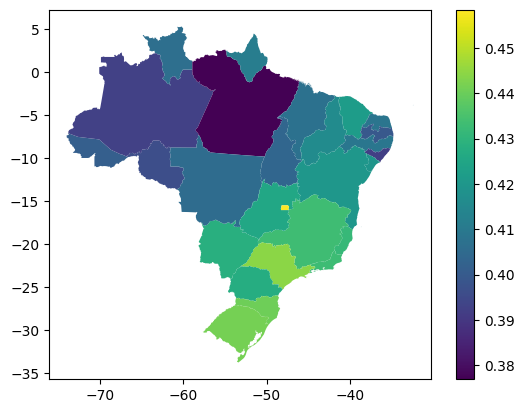

In [ ]:
#Mapping geodataframe
employment_br_state_gdf.plot(column='Percentage of occupied women',legend=True)

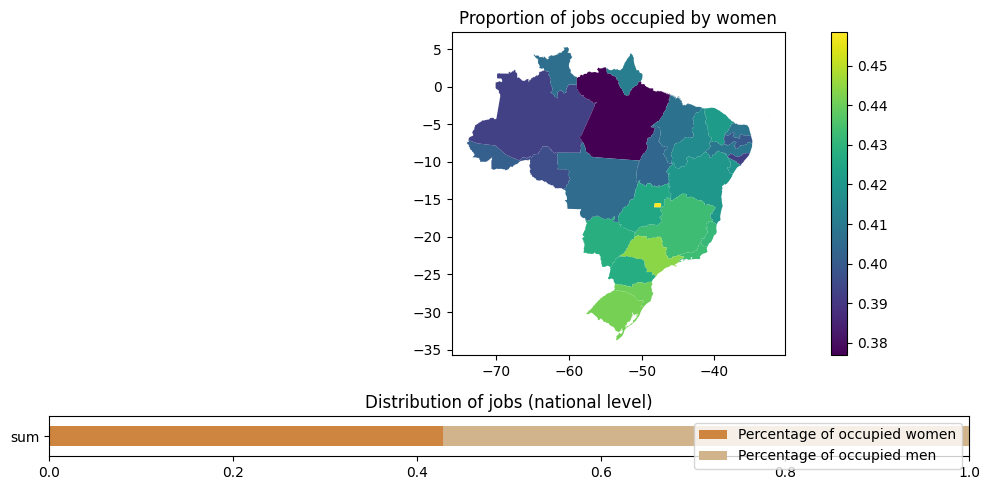

In [ ]:
#Mapping Participation in Labour
fig,ax = plt.subplots(ncols=1, nrows=2, figsize=(10, 5),height_ratios=[8,1])

color_women = 'peru' #just an initial choice of colors
color_men = 'tan'

employment_br_state_gdf.plot(column='Percentage of occupied women',legend=True,ax=ax[0])
employment_distribution_br.filter(['Percentage of occupied women', 'Percentage of occupied men']).plot(kind='barh', stacked=True,ax=ax[1],
                                color = [color_women, color_men])

ax[0].set_title('Proportion of jobs occupied by women')
ax[1].set_title('Distribution of jobs (national level)')
ax[1].set_xlim(0,1)

fig.tight_layout()

# Save in file
file_path = '/content/drive/MyDrive/DataScience/Data Science - Final project/outputs/'
file_name = 'Map of participation of labour of women in Brazil (2019)'
fig.savefig(file_path + file_name)

**Participation in labour observations:**

* States with lower HDI have the lower percentage of jobs occupied by women.
For source: http://www.atlasbrasil.org.br/ranking

<img src="https://upload.wikimedia.org/wikipedia/commons/thumb/a/a2/Mapa_dos_estados_brasileiros_por_IDH_%282021%29.svg/1280px-Mapa_dos_estados_brasileiros_por_IDH_%282021%29.svg.png" width="400"/>

Legend:
* Dark green (0,800-1,000) Very high HDI
* Green (0,700-0,799) High HDI
* Light green (0,600-0,699)

##### Income visualization


<Axes: >

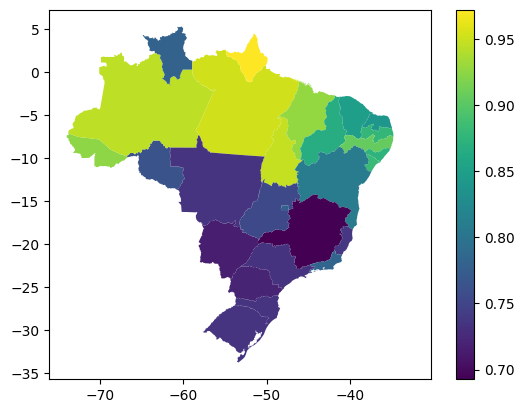

In [ ]:
#Mapping geodataframe
income_br_2019_gdf.plot(column='2019 Women/Men', legend=True)

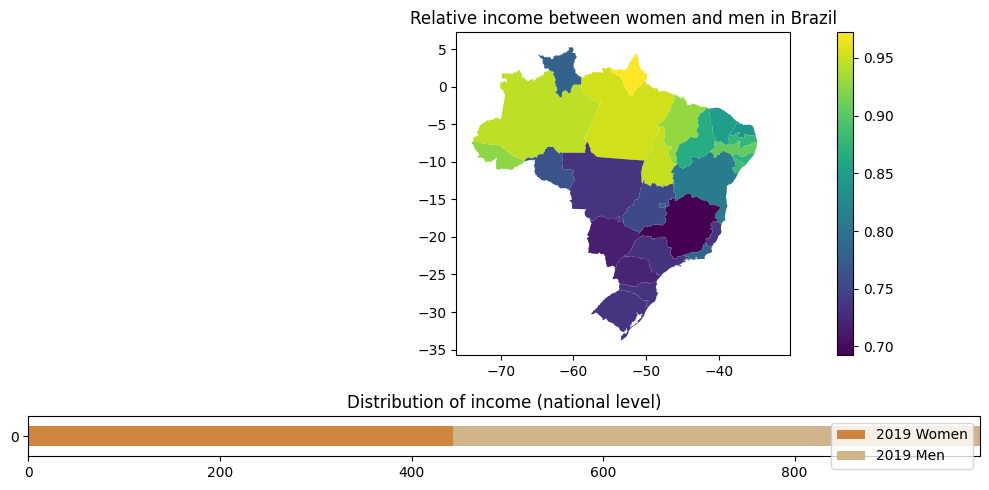

In [ ]:
fig, ax = plt.subplots(ncols=1, nrows=2, figsize=(10, 5),height_ratios=[8,1])

color_women = 'peru' #just an initial choice of colors
color_men = 'tan'

income_br_2019_gdf.plot(column='2019 Women/Men',legend=True,ax=ax[0])
income_br_national[['2019 Women','2019 Men']].plot(kind='barh', stacked=True, ax=ax[1],
                                color = [color_women, color_men])

ax[0].set_title('Relative income between women and men in Brazil')
ax[1].set_title('Distribution of income (national level)')
ax_limit = income_br_national['2019 Women'].iloc[0]+income_br_national['2019 Men'].iloc[0]
ax[1].set_xlim(0,ax_limit)

fig.tight_layout()

# Save in file
file_path = '/content/drive/MyDrive/DataScience/Data Science - Final project/outputs/'
file_name = 'Map of relative income in Brazil (2019).png'
fig.savefig(file_path + file_name)

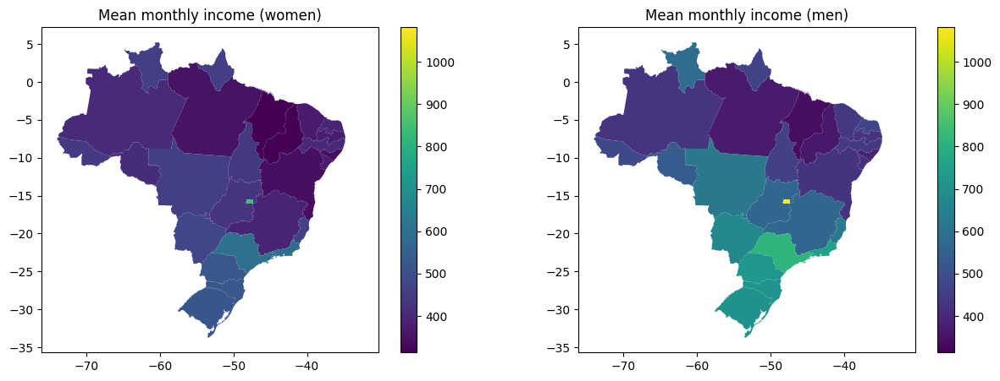

In [ ]:
fig, axs = plt.subplots(ncols=2, nrows=1, figsize=(15, 5))

max_income_legend = max([income_br_2019_gdf['2019 Women'].max(),income_br_2019_gdf['2019 Men'].max()])
min_incom_legend = min([income_br_2019_gdf['2019 Women'].min(),income_br_2019_gdf['2019 Men'].min()])

income_br_2019_gdf.plot(column='2019 Women',legend=True,ax=axs[0],
                    vmax = max_income_legend, vmin = min_incom_legend)
income_br_2019_gdf.plot(column='2019 Men',legend=True,ax=axs[1],
                    vmax = max_income_legend, vmin = min_incom_legend)

axs[0].set_title('Mean monthly income (women)')
axs[1].set_title('Mean monthly income (men)')

# Save in file
file_path = '/content/drive/MyDrive/DataScience/Data Science - Final project/outputs/'
file_name = 'Map comparison of income by gender in Brazil (2019).png'
fig.savefig(file_path + file_name)

**Income Observations:**

* The regions where women have **lower participation** in labour are also the regions where women's monthly income is **closer** to men's income.

* On the other hand, having income similar to the men in their states doesn't mean that women have higher income than women from states where the gender inequality is stronger. That is, northern states show a lower income gap between women and men, but they present overall lower wages than southern states.

* The **distribution of wages is less disperse for women** than for men across the Brazilian states: men from the southern states of the country have significantly greater wages than males from the north, but the patterns is not present for women.

#####Brazil data conclusions

Although the southern states of Brazil have an aparent greater participation of women in jobs, in terms of average wages, inequality is stronger in these states. That is, in these states women as a whole are participating more in the labour market, but at the same time men receive comparatively more payment than women in these states.

###Mexico

#####Participation in labour visualization

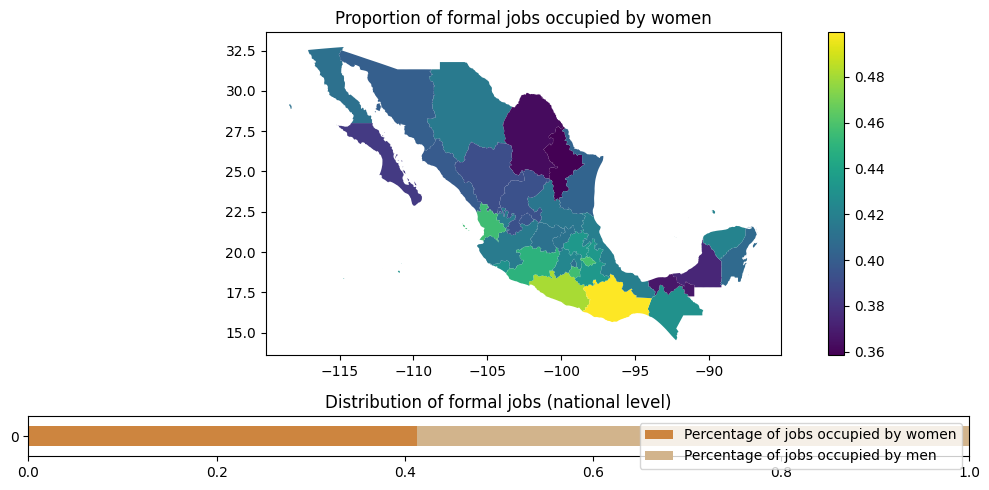

In [ ]:
#Mapping Participation in Labour
fig,ax = plt.subplots(ncols=1, nrows=2, figsize=(10, 5),height_ratios=[8,1])

color_women = 'peru' #just an initial choice of colors
color_men = 'tan'

# Produce map with a lower plotted stacked bar of national statistics
employment_mx_state_gdf.plot(column='Percentage of jobs occupied by women',legend=True,ax=ax[0])
employment_distribution_mx.plot(kind='barh', stacked=True,ax=ax[1],
                                color = [color_women, color_men])

# Customize appearance
ax[0].set_title('Proportion of formal jobs occupied by women')
ax[1].set_title('Distribution of formal jobs (national level)')
ax[1].set_xlim(0,1)

fig.tight_layout()

# Save in file
file_path = '/content/drive/MyDrive/DataScience/Data Science - Final project/outputs/'
file_name = 'Map of participation of labour of women in Mexico (2019).png'
fig.savefig(file_path + file_name)

**Participation in labour observations:**


* Some states of Mexico in the south with lower HDI or GDP ([Source](https://www.researchgate.net/figure/Human-development-index-by-municipalities-in-Mexico-38_fig17_293654075))
  have actually more proportion of formal positions occupied by women than their northern industrialised counterparts, in this case the pattern is reversed as in the case of Brazil.

* A further exploration by **type of economic activities** may enhance the analysis to review possible causes of the pattern.

####2. Income visualization

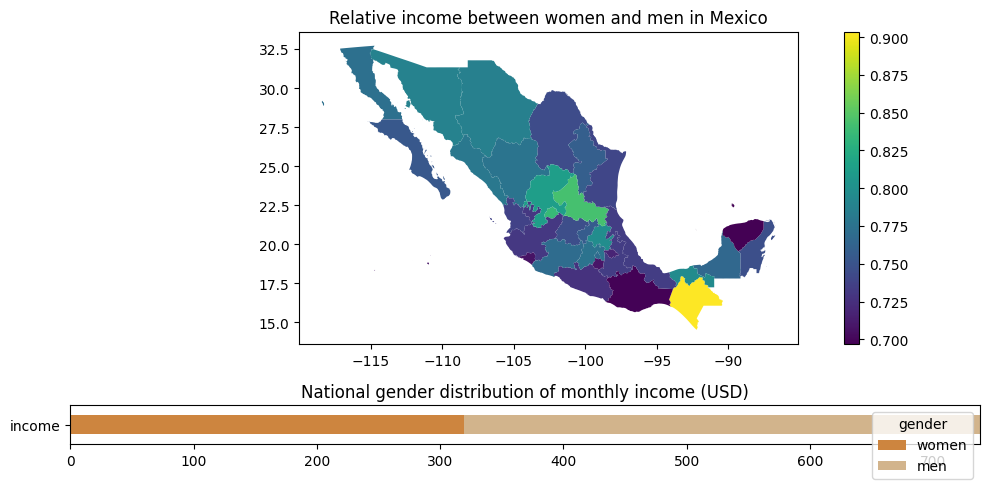

In [ ]:
# Map of relative income
fig, ax = plt.subplots(ncols=1, nrows=2, figsize=(10, 5),height_ratios=[8,1])

# Produce map with a lower plotted stacked bar of national statistics
income_mex_gdf.plot(column='women/men',legend=True,ax=ax[0])
income_mx_national[['women','men']].plot(kind='barh', stacked=True, ax=ax[1],
                                color = [color_women, color_men])

# Customize appearance
ax[0].set_title('Relative income between women and men in Mexico')
ax[1].set_title('National gender distribution of monthly income (USD)')
ax_limit = income_mx_national['women'].iloc[0] + income_mx_national['men'].iloc[0]
ax[1].set_xlim(0,ax_limit)
fig.tight_layout()

# Save in file
file_path = '/content/drive/MyDrive/DataScience/Data Science - Final project/outputs/'
file_name = 'Map of relative income in Mexico (2019).png'
fig.savefig(file_path + file_name)

In [ ]:
# Obtaining over states ranking over 80% in relative income
result = income_mex_gdf[['State Name','women/men']].sort_values(by='women/men',ascending=False)
result.query('`women/men` > 0.8')

,State Name,women/men
6,Chiapas,0.903782
23,San Luis Potosí,0.842876
0,Aguascalientes,0.835967
31,Zacatecas,0.812097


In [ ]:
#Querying three top states by means of participation of women
query_statement = '`State Name`== "Chiapas" or `State Name`== "San Luis Potosí" or `State Name`== "Aguascalientes"'
employment_mx_state_gdf[['State Name','Percentage of jobs occupied by women']].query(query_statement)

,State Name,Percentage of jobs occupied by women
0,Aguascalientes,0.396026
6,Chiapas,0.429462
24,San Luis Potosí,0.413981


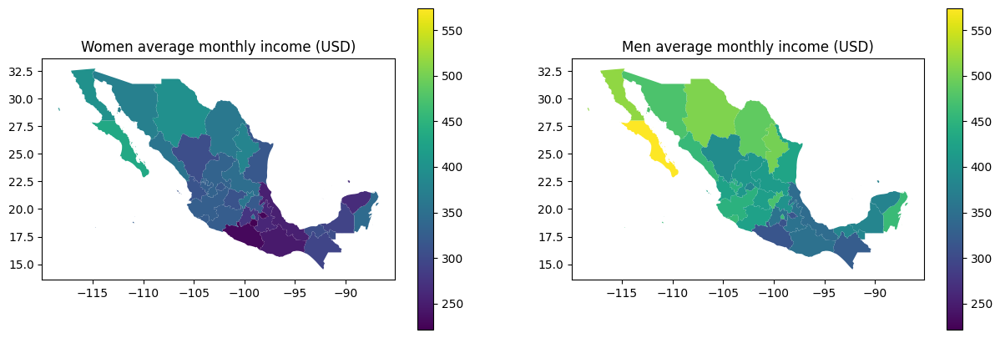

In [ ]:
# Comparison map of income between women and men
fig, axs = plt.subplots(ncols=2, nrows=1, figsize=(15, 5))

max_income_legend = max([income_mex_gdf['women'].max(),income_mex_gdf['men'].max()])
min_incom_legend = min([income_mex_gdf['women'].min(),income_mex_gdf['men'].min()])

income_mex_gdf.plot(column='women',legend=True,ax=axs[0],
                    vmax = max_income_legend, vmin = min_incom_legend)
income_mex_gdf.plot(column='men',legend=True,ax=axs[1],
                    vmax = max_income_legend, vmin = min_incom_legend)

axs[0].set_title("Women average monthly income (USD)")
axs[1].set_title("Men average monthly income (USD)")

# Save in file
file_path = '/content/drive/MyDrive/DataScience/Data Science - Final project/outputs/'
file_name = 'Map comparison of income by gender in Mexico (2019).png'
fig.savefig(file_path + file_name)

**Income observations:**

* A general pattern of lower incomes in the southern states is visible for both genders.

* The **center** and **northwestern** regions of the country show a lower income gap. Of particular interest are the states of Chiapas, San Luis Potosí, and Aguascalientes, which ranked higher in relative income (>80%), but appear to be closer to the national mean of women participation in labour (41%).

* In the case of Mexico, the states with greater realtive income are not the states with lower income for both men and women, as was the case for Brazil.





####Mexico data conclusions

In the case of Mexico, the participation-relative income pattern is similar to that in Brazil: Mexican states where women participation is higher have higher income inequality.

### <img src="https://w0.peakpx.com/wallpaper/47/295/HD-wallpaper-the-one-ring-lotr-rings-fantasy.jpg" width="45"/> The One Chart to show them all



In [ ]:
# Calculate National-level
income_mx_stats = income_mx.filter(items=['men','women','total population']).agg(['mean', 'std', 'min', 'max'])
income_mx_stats

,men,women,total population
mean,416.130290,317.468854,376.541863
std,65.468137,52.777551,59.758895
min,312.039853,221.231816,276.012752
max,574.120436,432.422949,515.221820


In [ ]:
income_br_stats = income_br_2019.filter(items=['2019 Total','2019 Women', '2019 Men']).agg(['mean', 'std', 'min', 'max'])
income_br_stats

,2019 Total,2019 Women,2019 Men
mean,505.200521,443.352113,550.279536
std,140.984758,109.102157,169.938528
min,329.437442,314.020419,339.377365
max,970.258180,839.010628,1081.017320


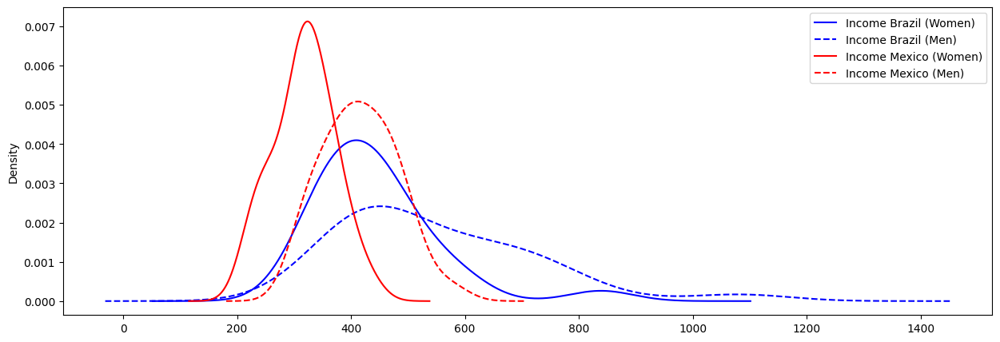

In [ ]:
# Plot distribution in a graph
# men and women, both countries: income_br_2019, income_mx
fig, ax = plt.subplots(ncols=1, nrows=1, figsize=(15, 5))

income_br_2019['2019 Women'].plot(kind='kde', color='blue', legend=True, ax =ax)
income_br_2019['2019 Men'].plot(kind='kde', color='blue', legend=True, ls='--',ax =ax)
income_mx['women'].plot(kind='kde', legend=True, color='red',ax =ax)
income_mx['men'].plot(kind='kde', legend=True, color='red', ls='--',ax =ax)

plt.legend(['Income Brazil (Women)','Income Brazil (Men)','Income Mexico (Women)','Income Mexico (Men)'])



# Save in file
file_path = '/content/drive/MyDrive/DataScience/Data Science - Final project/outputs/'
file_name = 'Distribution of income across states in Brazil and Mexico for Women and Men (2019).png'
fig.savefig(file_path + file_name)

plt.show()



**Income distribution observations**
* As said, men in Brazil show a greater dispersion of wages across different states as women. Although the pattern is still present in Mexico, it is not as strong as in Brazil.

* In both cases the shift of the curves between women and men show the gender gap in the order of hundreds of dollars.

###Map overlay
Mulitple maps as layers of a single map



#### Mexico

In [ ]:
# Create color maps
from branca.colormap import linear

cmap_rel_income_mx = linear.viridis.scale(
    income_mex_gdf['women/men'].min(),
    income_mex_gdf['women/men'].max()
)

cmap_participation_mx = linear.viridis.scale(
    employment_mx_state_gdf['Percentage of jobs occupied by women'].min(),
    employment_mx_state_gdf['Percentage of jobs occupied by women'].max()
)

In [ ]:
# Define basemap
mx_city_location = [19.3907924,-99.4551171]
map_mx = folium.Map(location=mx_city_location, zoom_start=4.25,tiles="cartodbpositron",
                 #zoom_control=False,
                 #scrollWheelZoom=False,
                 #dragging=False
                 )

In [ ]:
fg_income = folium.FeatureGroup(name='relative income')
fg_participation = folium.FeatureGroup(name='participation')

In [ ]:
# https://stackoverflow.com/questions/53637053/folium-color-mapping-when-adding-geojson-to-the-map/53816162#53816162
for index, row in employment_mx_state_gdf[['Percentage of jobs occupied by women', 'geometry']].iterrows():
    fillColor = cmap_participation_mx(row['Percentage of jobs occupied by women'])
    color="black"
    # Without simplifying the representation of each borough,
    # the map might not be displayed
    sim_geo = gpd.GeoSeries(row["geometry"]).simplify(tolerance=0.001)
    geo_j = sim_geo.to_json()
    geo_j = folium.GeoJson(data=geo_j, style_function=lambda x, fillColor=fillColor, color="black": {
            "fillColor": fillColor,
            "color": "black",
            "weight": 1,
        "dashArray": "5, 5",
        "fillOpacity": 0.8
        })
    geo_j.add_to(fg_participation)


In [ ]:
for index, row in income_mex_gdf[["women/men", 'geometry']].iterrows():
    fillColor = cmap_rel_income_mx(row["women/men"])
    color="black"
    # Without simplifying the representation of each borough,
    # the map might not be displayed
    sim_geo = gpd.GeoSeries(row["geometry"]).simplify(tolerance=0.001)
    geo_j = sim_geo.to_json()
    geo_j = folium.GeoJson(data=row["geometry"],  style_function=lambda x, fillColor=fillColor, color="black": {
            "fillColor": fillColor,
            "color": "black",
            "weight": 1,
        "dashArray": "5, 5",
        "fillOpacity": 0.8
        })
    geo_j.add_to(fg_income)


In [ ]:
fg_income.add_to(map_mx) #map not showing when added more than one layer
fg_participation.add_to(map_mx)

cmap_rel_income_mx.caption = 'Relative income women/men'
cmap_rel_income_mx.add_to(map_mx)

cmap_participation_mx.caption = 'Percentage of jobs occupied by women'
cmap_participation_mx.add_to(map_mx)

folium.LayerControl().add_to(map_mx)

map_mx

In [ ]:
# Save in file
file_path = '/content/drive/MyDrive/DataScience/Data Science - Final project/outputs/'
file_name = 'Interactive map of Mexico with distribution of income and participation in labour.html'
map_mx.save(file_path+file_name)

#### Brazil

In [ ]:
cmap_rel_income_br = linear.viridis.scale(
    income_br_2019_gdf['2019 Women/Men'].min(),
    income_br_2019_gdf['2019 Women/Men'].max()
)

cmap_participation_br = linear.viridis.scale(
    employment_br_state_gdf['Percentage of occupied women'].min(),
    employment_br_state_gdf['Percentage of occupied women'].max()
)

In [ ]:
brasilia_location = [-15.7217621,-47.9373578]
map_br = folium.Map(location=brasilia_location, zoom_start=4.25,tiles="cartodbpositron",
                #  zoom_control=False,
                #  scrollWheelZoom=False,
                #  dragging=False
                 )

In [ ]:
fg_income = folium.FeatureGroup(name='relative income')
fg_participation = folium.FeatureGroup(name='participation')

In [ ]:
# https://stackoverflow.com/questions/53637053/folium-color-mapping-when-adding-geojson-to-the-map/53816162#53816162
for index, row in employment_br_state_gdf[['Percentage of occupied women', 'geometry']].iterrows():
    fillColor = cmap_participation_br(row['Percentage of occupied women'])
    color="black"
    # Without simplifying the representation of each borough,
    # the map might not be displayed
    sim_geo = gpd.GeoSeries(row["geometry"]).simplify(tolerance=0.001)
    geo_j = sim_geo.to_json()
    geo_j = folium.GeoJson(data=geo_j, style_function=lambda x, fillColor=fillColor, color="black": {
            "fillColor": fillColor,
            "color": "black",
            "weight": 1,
        "dashArray": "5, 5",
        "fillOpacity": 0.8
        })
    geo_j.add_to(fg_participation)

In [ ]:
for index, row in income_br_2019_gdf[['2019 Women/Men', 'geometry']].iterrows():
    fillColor = cmap_rel_income_br(row['2019 Women/Men'])
    color="black"
    # Without simplifying the representation of each borough,
    # the map might not be displayed
    sim_geo = gpd.GeoSeries(row["geometry"]).simplify(tolerance=0.001)
    geo_j = sim_geo.to_json()
    geo_j = folium.GeoJson(data=row["geometry"],  style_function=lambda x, fillColor=fillColor, color="black": {
            "fillColor": fillColor,
            "color": "black",
            "weight": 1,
        "dashArray": "5, 5",
        "fillOpacity": 0.8
        })
    geo_j.add_to(fg_income)

In [ ]:
fg_income.add_to(map_br) #map not showing when added more than one layer
fg_participation.add_to(map_br)

cmap_rel_income_mx.caption = 'Relative income women/men'
cmap_rel_income_mx.add_to(map_br)

cmap_participation_mx.caption = 'Percentage of jobs occupied by women'
cmap_participation_mx.add_to(map_br)

folium.LayerControl().add_to(map_br)

map_br

In [ ]:
# Save in file
file_path = '/content/drive/MyDrive/DataScience/Data Science - Final project/outputs/'
file_name = 'Interactive map of Brazil with distribution of income and participation in labour.html'
map_br.save(file_path+file_name)

## FINAL REFLECTIONS

### Summary of the results

The data analysis and visualization in this study demonstrated the existing gender gap in terms of financial inclusion. Moreover, a general spatial description was made with the outputs of results research.



### Difficulties encountered

One of the main problems that we faced during the project was the harmonization of data between the two countries to obtain comparable results. Formats contrasted between the sources found and we had to perform different data transformations to obtain a common framework.
Other difficulties were:
1. To understand specific terms of the domain of the problem. For example, exchangeable terms like "state", "province", "district".
2. Some datasets from Mexico were really granular with multiple files to download and proccess.
3. Working on the notebook simultaneously was a challenge, because it generated conflicts. Good communication solved the situation, but we miss having a built-in option like displaying who is working in the document (like in Google Docs).

### Take-away message

It is important to study multiple and contrasting indexes to measure demographic features, since one possible interpretation of a phenomenon can be dependant on the unit and scope of the data analyzed.

## REFERENCES

Instituto Nacional de Estadística y Geografía (México). Mujeres y hombres en México 2019 / Instituto Nacional de Estadística y
Geografía.-- México : INEGI, c2019. Available at: https://www.inegi.org.mx/contenido/productos/prod_serv/contenidos/espanol/bvinegi/productos/nueva_estruc/702825189990.pdf



Economic Gender-Based Violence - The ECOVIO project. Available at: https://economic-genderviolence.eu/

La Violencia Económica y Patrimonial como Violencia de Género: Hacia la construcción de estrategias para fortalecer el acceso a derechos. Available at: https://www.segib.org/wp-content/uploads/Violencia-Economica-y-Patrimonial_IIPEVCM-ES.pdf

Estatísticas de Gênero - Indicadores sociais das mulheres no Brasil. Available at: https://www.ibge.gov.br/estatisticas/multidominio/genero/20163-estatisticas-de-genero-indicadores-sociais-das-mulheres-no-brasil.html?edicao=30167&t=resultados